# New best fit

### Puzzle piece generation

We use the CUB-200 dataset to generate our puzzles : http://www.vision.caltech.edu/visipedia/CUB-200.html

Each image will give rise to a puzzle as follows: We'll cut up the image into uniform square pieces of a given dimension. We'll rotate each square puzzle piece randomly by (0 or 90 or 180 or 270 degrees) and we'll shuffle the order of the square pieces randomly and return these randomly rotated pieces in their shuffled order.



In [1]:
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.ticker as plticker
import os

import pprint
import itertools
from collections import defaultdict
import copy

# generate random integer values
import random
from random import seed
from random import randint
import numpy as np
from pylab import array
from random import sample
import math


import model


import torch
from torch.utils.data import Dataset, DataLoader, IterableDataset
from torchvision import transforms, utils
from torch import nn, optim
from torchvision import datasets, transforms
#from torchvision.utils import make_grid

Notation: Imagine cutting up the image into r rows and c cols so that each piece is a square.

row number starts from 0 and goes to r-1 (top row is 0, bottom row is r-1)

col number starts from 0 and goes to c-1 (left most col is 0, right most col is c-1)

We scan from 0th row to the end row and in each row, we scan from 0_th col to c-1_st col


The piece in the i_th row, j_th col of the image is refered to by the label (i,j)


So list_of_labels is [(0,0), (0,1), ..(0, c-1), (1,0), ..(1,c-1),.....(r-1,0), ...(r-1,c-1)]

In [2]:
# Helper function to visualize the cutting up process and labels.
# Ignore the code for this function, just look at the sample run of it to visualize

def visualize_grid_and_labels(image_file_name, puzzle_square_piece_dim):
    """Draws the puzzle grid with each piece labelled
    """
    
    
    #opening the image as a PIL image object
    my_image = Image.open(image_file_name)
    #my_image.show()
    original_image_length = my_image.size[0]
    original_image_width =  my_image.size[1] 
    
    #Each puzzle piece is a square of dimension puzzle_square_piece_dim
    puzzle_piece_length = puzzle_square_piece_dim
    puzzle_piece_width = puzzle_square_piece_dim
    
    #Resizing the image so that it can be cut up into integer number of square pieces
    rows = original_image_length // puzzle_piece_length
    cols =  original_image_length // puzzle_piece_width
    new_image_length = rows*puzzle_piece_length
    new_image_width = cols*puzzle_piece_width
    
    #Resizing the image so that it can be cut up into integer number of square pieces
    my_image = my_image.resize((new_image_length, new_image_width))
    #my_image.show()
    
    # Set up figure
    my_dpi = 100 #seems to be the font size + line thickness
    #fig=plt.figure(figsize=(float(w)/my_dpi,float(h)/my_dpi),dpi=my_dpi)
    fig = plt.figure(dpi = my_dpi)
    
    #subplot(mni) breaks the figure window into an m-by-n matrix of small subplots
    #and selects the i_th subplot for the current plot. 
    #The plots are numbered along the top row of the figure window, then the second row, and so forth.
    
    ax=fig.add_subplot(1,1,1)
    
    # Remove whitespace from around the image
    fig.subplots_adjust(left=0,right=1,bottom=0,top=1)
    
    
    # Set the gridding interval: here we use the major tick interval
    #Within each axis, there is the concept of a major tick mark, and a minor tick mark. 
    #Major ticks are usually bigger or more pronounced,
    #while minor ticks are usually smaller. 
    
    #For a basic tutorial on plt.ticks - https://www.geeksforgeeks.org/python-matplotlib-pyplot-ticks/
    
    #each tick is puzzle_square_piece_dim units apart
    #https://matplotlib.org/3.1.1/gallery/ticks_and_spines/tick-locators.html
    myInterval=puzzle_square_piece_dim
    loc = plticker.MultipleLocator(base=myInterval)
    
    ax.xaxis.set_major_locator(loc)
    ax.yaxis.set_major_locator(loc)
    
    # Add the grid
    ax.grid(which='major', axis='both', linestyle='-',color='white')
    
    # Add the image
    ax.imshow(my_image)

    # Find number of gridsquares in x and y direction
    nx=abs(int(float(ax.get_xlim()[1]-ax.get_xlim()[0])/float(myInterval)))
    ny=abs(int(float(ax.get_ylim()[1]-ax.get_ylim()[0])/float(myInterval)))
    
    #nx = cols
    #ny = rows


    # Add some labels to the gridsquares
    for i in range(rows):
        y=myInterval/2+i*myInterval
        for j in range(cols):
            x=myInterval/2.+float(j)*myInterval
            ax.text(x,y,'({:d},{:d})'.format(i,j),color='red',ha='center',va='center')

    # Save the figure
    #fig.savefig('current_bird_image_grid.jpeg',dpi=my_dpi)
    plt.show()
       

    
    

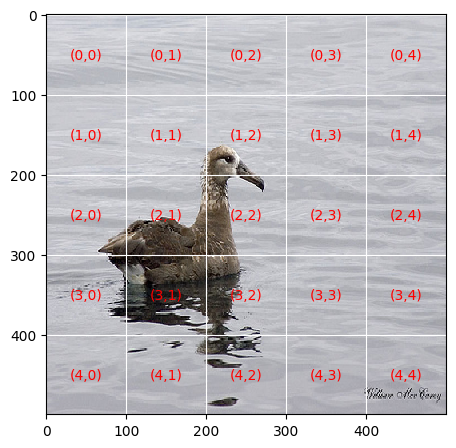

In [3]:
visualize_grid_and_labels('/Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/001.Black_footed_Albatross/Black_footed_Albatross_0007_2675126617.jpg',100)

The following function takes as input an image file and the dimension of the square puzzle piece.


Recall we want to cut up the image into these uniform square puzzle piece shapes.


As we scan from top to bottom row and in each row, from left to right col, we create the puzzle pieces by cropping the image appropriately and give them their old labels (which row they are in original image, which col they are in original image).


We also rotate them randomly at the time of their creation and store by how much we are rotating them


We then generate a permutation of the old labels to give the new labels



Interpretation of shuffling: If puzzle piece with old label (x,y) gets a new label (a,b), this means that in the shuffled image, the puzzle piece in row a and col b is actually the puzzle piece that was in row x and col y in the original image.


We return the dictionary [new labels : old labels, angle of rotation of the old label piece] and the shuffled image pieces as numpy arrays






In [4]:
def get_puzzle_pieces(image_file_name,puzzle_square_piece_dim):
    """Get the shuffled and randomly rotated puzzle pieces 
       given an image and the dim of each square puzzle piece """
    
    #opening the image as a PIL image object
    my_image = Image.open(image_file_name)
    #my_image.show()
    
    #getting original image length and width
    original_image_length = my_image.size[0]
    original_image_width =  my_image.size[1] 
    
    #Each puzzle piece is a square of dimension puzzle_square_piece_dim
    puzzle_piece_length = puzzle_square_piece_dim
    puzzle_piece_width = puzzle_square_piece_dim
    
    #Resizing the image so that it can be cut up into integer number of square pieces
    rows = original_image_length // puzzle_piece_length
    cols =  original_image_length // puzzle_piece_width
    new_image_length = rows*puzzle_piece_length
    new_image_width = cols*puzzle_piece_width
    no_of_puzzle_pieces = rows*cols
    
    
    #Sanity check print statements
    print("****************")
    print(f"puzzle_piece_length is {puzzle_piece_length}")
    print(f"puzzle_piece_width is {puzzle_piece_width}")
    print(f"no of rows are {rows}")
    print(f"no of cols are {cols}")
    print(f"no_of_puzzle_pieces are {no_of_puzzle_pieces}")
    
    #Resizing the image so that it can be cut up into integer number of square pieces
    my_image = my_image.resize((new_image_length, new_image_width))
    #my_image.show()
    
    
    #list_of_labels is [(0,0), (0,1), ..(0, c-1), (1,0), ..(1,c-1),.....(r-1,0), ...(r-1,c-1)]
    


    #We create these r*c number of pieces by cropping the image appropriately
    #We go from top to bottom row and in each row, from left to right cols.
    #For each puzzle piece we create, we also randomly rotate it by 0, 90, 180 or 270 degrees
    #We record how much we rotate each piece by as we do this in a list called puzzle_pieces_orientation
    #We store the puzzle pieces as we generate them in a list called puzzle_pieces
    
    
    puzzle_pieces = []
    puzzle_pieces_orientation = []
    list_of_labels = []
    i = 0
    j = 0
    
    while(i < rows):
        #row_puzzle_pieces = []
        #row_puzzle_pieces_orientation = []
        while(j < cols):
            list_of_labels.append((i,j))
            random_int = randint(0,3)
            angle_of_rotation = 90*(random_int)
            puzzle_pieces_orientation.append(random_int)
            puzzle_pieces.append(my_image.crop((j*puzzle_piece_width,i*puzzle_piece_length,(j+1)*puzzle_piece_width,(i+1)*puzzle_piece_length)).rotate(angle_of_rotation))
            j += 1
        #puzzle_pieces.append(row_puzzle_pieces)
        #puzzle_pieces_orientation.append(row_puzzle_pieces_orientation)
        i += 1
        j = 0
    
    
    #new_labels is a permutation of list_of_labels
    new_labels = sample(list_of_labels, len(list_of_labels))
   
    #puzzle piece with old label (x,y) gets a new label which is new_label[x*cols + y]  = (a,b) say.
    #i.e., in the shuffled image, the puzzle piece is row a and col b is
    #actually the puzzle piece that was in row x and col y in the original image.
    
    
    #new_to_old_label dict takes as input the new label and returns the old label 
    #along with the angle of rotation of the puzzle piece under consideration
    
    top_left_piece_new_label= None
    new_to_old_label_dict = {}
    for new_label, old_label  in zip(new_labels, list_of_labels):
        x, y = old_label
        new_to_old_label_dict[new_label] = (x,y, puzzle_pieces_orientation[x*cols+y])
        if x==0 and y==0:
            top_left_piece_new_label = new_label
            top_left_piece_orientation = puzzle_pieces_orientation[x*cols+y]
    
    
    #Storing the shuffled pieces as numpy arrays in a list
    #We again scan the shuffled image from top to botton row and in each row, scan from left to right cols
    
    shuffled_puzzle_pieces_np = []
    
    
    i = 0
    j = 0
    while(i < rows):
        #shuffled_row = []
        while(j < cols):
            x, y, theta = new_to_old_label_dict[(i,j)] 
            shuffled_piece = puzzle_pieces[x*cols+y]
            shuffled_puzzle_pieces_np.append(array(shuffled_piece))
            j += 1
        #shuffled_puzzle_pieces_np.append(shuffled_row)
        i += 1
        j = 0
        
    
    my_dpi = 100 #seems to be the font size + line thickness
    fig = plt.figure(dpi = my_dpi)
    
    #subplot(mni) breaks the figure window into an m-by-n matrix of small subplots
    #and selects the i_th subplot for the current plot. 
    #The plots are numbered along the top row of the figure window, then the second row, and so forth.
    
    # Add the original image
  
    for i, piece in enumerate(shuffled_puzzle_pieces_np):
            img = Image.fromarray(piece, 'RGB')
            ax=fig.add_subplot(rows,cols,i+1)
            ax.imshow(img)
    plt.show()

    
    return rows, cols, top_left_piece_new_label, top_left_piece_orientation, new_to_old_label_dict, shuffled_puzzle_pieces_np
    
    

****************
puzzle_piece_length is 100
puzzle_piece_width is 100
no of rows are 5
no of cols are 5
no_of_puzzle_pieces are 25


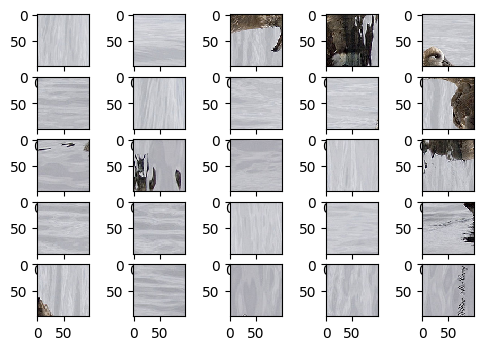

In [5]:
test_input = get_puzzle_pieces('/Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/001.Black_footed_Albatross/Black_footed_Albatross_0007_2675126617.jpg',100)

To go between new label and position in shuffled_puzzle_pieces_np list,...

<ul>
    <li> piece with new label <b>(x,y)</b> is shuffled_puzzle_pieces_np[<b>x*cols + y</b>] </li>
    <li> piece with position <b>i</b> in shuffled_puzzle_pieces_np has new label (x,y) where
              <ul>
                  <li> <b>x = i // cols </b></li>
                  <li> <b>y = i mod (cols)</b> </li>
                  </ul></li>
</ul>



### Loading the model

<i>NB - All rotations in this notebook are clockwise  
NB2 - Adjacency of a puzzle-piece tuple (P,Q) means P and Q are next to each other so that P's right vertical edge and Q's left vertical edge coincide </i>

In [6]:
def load_checkpoint(checkpoint_path, model, optimizer):
    """
    checkpoint_path: path where checkpoint was saved
    model: model into which we want to load our checkpoint     
    optimizer: optimizer into which we want to load our checkpoint
    """

    checkpoint = torch.load(checkpoint_path)
    
    model.load_state_dict(checkpoint['state_dict'])
    
    optimizer.load_state_dict(checkpoint['optimizer'])
    
    min_validation_loss = checkpoint['min_validation_loss']
    
    fc_weight = checkpoint['fc_weight']
        
    fc_bias = checkpoint['fc_bias'] 
    
    return model, optimizer, checkpoint['epoch'], min_validation_loss, fc_weight, fc_bias

In [7]:
my_learning_rate = 1e-3
my_momentum = 0.9
my_num_classes = 2
my_feature_extract = False
my_model_name = "resnet"

In [8]:
my_model = model.make_model(my_model_name, my_num_classes, my_feature_extract, use_pretrained=True)
my_loss_criterion = model.make_loss_criterion()
my_optimizer = model.make_optimizer(model.params_to_update(my_model, my_feature_extract), my_learning_rate, my_momentum)
my_best_model_path = "./best_model.pt"

Params to learn:
	 conv1.weight
	 bn1.weight
	 bn1.bias
	 layer1.0.conv1.weight
	 layer1.0.bn1.weight
	 layer1.0.bn1.bias
	 layer1.0.conv2.weight
	 layer1.0.bn2.weight
	 layer1.0.bn2.bias
	 layer1.1.conv1.weight
	 layer1.1.bn1.weight
	 layer1.1.bn1.bias
	 layer1.1.conv2.weight
	 layer1.1.bn2.weight
	 layer1.1.bn2.bias
	 layer2.0.conv1.weight
	 layer2.0.bn1.weight
	 layer2.0.bn1.bias
	 layer2.0.conv2.weight
	 layer2.0.bn2.weight
	 layer2.0.bn2.bias
	 layer2.0.downsample.0.weight
	 layer2.0.downsample.1.weight
	 layer2.0.downsample.1.bias
	 layer2.1.conv1.weight
	 layer2.1.bn1.weight
	 layer2.1.bn1.bias
	 layer2.1.conv2.weight
	 layer2.1.bn2.weight
	 layer2.1.bn2.bias
	 layer3.0.conv1.weight
	 layer3.0.bn1.weight
	 layer3.0.bn1.bias
	 layer3.0.conv2.weight
	 layer3.0.bn2.weight
	 layer3.0.bn2.bias
	 layer3.0.downsample.0.weight
	 layer3.0.downsample.1.weight
	 layer3.0.downsample.1.bias
	 layer3.1.conv1.weight
	 layer3.1.bn1.weight
	 layer3.1.bn1.bias
	 layer3.1.conv2.weight
	 layer3.1.b

In [9]:
my_model, my_optimizer, start_epoch, min_validation_loss, my_fc_weight, my_fc_bias = load_checkpoint(my_best_model_path, my_model, my_optimizer)
my_model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [10]:
print(my_fc_weight)
print(my_fc_bias)

Parameter containing:
tensor([[ 0.0596, -0.0073, -0.0275,  ...,  0.0013,  0.0551, -0.0242],
        [-0.0339, -0.0466,  0.0434,  ...,  0.0299,  0.0161,  0.0044]],
       requires_grad=True)
Parameter containing:
tensor([0.0143, 0.0350], requires_grad=True)


In [11]:
 def transform_input(piece_1, piece_2, resnet_dim):
        width = resnet_dim
        height = resnet_dim
        piece_1 = piece_1.resize((width, height))
        piece_2 = piece_2.resize((width, height))
        juxtaposed = Image.new('RGB', (2*width, height), color=0)
        #juxtaposed.paste(piece_i ,
        #(left_upper_row, left_upper_col, 
        #right_lower_row, right_lower_col))
        juxtaposed.paste(piece_1,(0,0,width, height))
        juxtaposed.paste(piece_2,(width,0,2*width, height))
        juxtaposed = juxtaposed.crop((width//2, 0,width//2 + width,height))
        return transforms.ToTensor()(juxtaposed)

In [12]:
def pairwise_adj_prob(P, Q, R, S, resnet_dim):   
    #rotate Puzzle piece P by 90R degrees clockwise
    #rotate Puzzle piece Q by 90S degrees clockwise
    #model(P,Q)
    piece_1 = Image.fromarray(P, 'RGB').rotate(-90*R)
    piece_2 = Image.fromarray(Q, 'RGB').rotate(-90*S)
    
    with torch.no_grad():
            juxtaposed_pieces_torchtensor = transform_input(piece_1, piece_2, resnet_dim)
            new_input_torchtensor = juxtaposed_pieces_torchtensor.unsqueeze(0)
            outputs = my_model(new_input_torchtensor)
            predicted_label_probabilities = torch.nn.Softmax(dim=1)(outputs)
            predicted_label_probabilities_numpy = predicted_label_probabilities.numpy()
            #print(f"predicted_label_probabilities_numpy is {predicted_label_probabilities_numpy}")
            return predicted_label_probabilities_numpy[0,1]

We want to store the precomputed information in the following format:  

*Instead of storing Pieces P, Q ..., we'll store their positions in the shuffled_puzzle_pieces_np array

In [28]:
def computation(information_dict, shuffled_puzzle_pieces_np, resnet_dim, P, Q, R, S):
    N = len(shuffled_puzzle_pieces_np)
    if ((P,R) not in information_dict):
        information_dict[(P,R)] = {Q: {}}
    elif (Q not in information_dict[(P,R)]):
        information_dict[(P,R)][Q] = {}
    if S not in information_dict[(P,R)][Q]:
        information_dict[(P,R)][Q][S] = pairwise_adj_prob(shuffled_puzzle_pieces_np[P], 
                                                      shuffled_puzzle_pieces_np[Q], 
                                                      R, S, resnet_dim)
        R_ = (R + 2) % 4
        S_ = (S + 2) % 4
        if ((Q,S_) not in information_dict):
            information_dict[(Q,S_)] = {P: {}}
        elif (P not in information_dict[(Q,S_)]):
            information_dict[(Q,S_)][P] = {}
        assert(R_ not in information_dict[(Q,S_)][P]),"Symmetric entry already computed unexpectedly"
        information_dict[(Q,S_)][P][R_] = information_dict[(P,R)][Q][S]
    return information_dict[(P,R)][Q][S]

In [29]:
# def predict_adj_piece(information_dict, P, R, shuffled_puzzle_pieces_np):
#     Q = None
#     d = math.inf
#     S = None
#     my_dpi =50
#     fig = plt.figure(dpi = my_dpi)


#     my_dict = information_dict[(P,R)][0]
#     for piece in my_dict:
#         for i in range(4):
#             d_ = my_dict[piece][i]
#             if d_ < d:
#                 Q = piece
#                 S = i
#                 d = d_

#     left_piece = Image.fromarray(shuffled_puzzle_pieces_np[P], 'RGB').rotate(-90*R)
#     right_piece = Image.fromarray(shuffled_puzzle_pieces_np[Q], 'RGB').rotate(-90*S)
#     w, h = left_piece.size
#     pasted_together_image = Image.new('RGB', (2*w,h), color=0)
#     pasted_together_image.paste(left_piece,(0,0,h,w))
#     pasted_together_image.paste(right_piece,(h,0,2*h,w))
#     ax=fig.add_subplot(1,1,1)
#     ax.imshow(pasted_together_image)
#     plt.show()
    
#     return (Q, S, d)

### Class PuzzleBoard 

We now define a python class called PuzzleBoard  



#### Attributes of PuzzleBoard

It will have the following attributes
<ul>
    <li> rows = number of rows of the puzzle board</li>
    <li> cols = number of rows of the puzzle board</li>
    <li> open_slots =  set of tuples (i,j) which are the slots in the puzzle board not yet filled in</li>
    <li> state = the current state of the puzzle board. We will explain below what constitutes the state of the board</li>
    <li> informed_guesses =  current guesses (distances) about how the remaining puzzle pieces fit into the remaining open slots (The initial informed_guesses is exactly the dictionary returned by the precomputation function above)</li>
    <li> predicted_new_to_old_dict = a dictionary with key value pairs 
        
        new label of a piece: (predicted old label of a piece, predicted anticlockwise rotation)
   </li>
</ul>


<b>State of the board</b> : It is a dictionary where the keys are tuples (i,j) referring to slots (open/filled) in the board. The value of the key (i,j) stores information about 
<ul><li> whether the slot of open </li>
    <li> any neighbours of the slot</li>
</ul>


More precisely ..

where 

<ul>
    <li>Neighbour 0 of a piece =  its left neighbour </li>
    <li>Neighbour 1 of a piece = its top neighbour </li>
    <li>Neighbour 2 of a piece = its right neighbour</li>
    <li>Neighbour 3 of a piece = its bottom neighbour</li>
    <li> is_open = True if slot open, False otherwise </li>
</ul>


<i> If there is no neighbour i for a piece, then entry for neighbour i is (None, None)</i>


#### Methods of PuzzleBoard

It will have the following methods
<ul>
    <li> fit the given top left piece</li>
    <li> find best (piece, rotation, open_slot) to fit </li>
    <li> fit (piece, rotation, open_slot) into the board </li>
</ul>


<b>Fitting Piece P with rotation R in open slot O</b> : 

<ul>
    <li> Delete O from open_slots</li>
    <li> Update state of the puzzle board</li>
    <li> Update informed_guesses </li>
    <li> Update the predicted_new_to_old_dict </li>
</ul>

### Choosing the best (piece, rotation, open_slot) to fit

For every left over piece P, for every rotation R and for every remaining open slot O, we calculate $f(P,R,O)$ to measure how "snugly" P,R fits in O as follows:

Let $(N_0, R_0)$, $(N_1,R_1)$, $(N_2,R_2)$, $(N_3,R_3)$ be the neighbours of open slot O ($(N_i, R_i)$ can be (None, None)). 


For each neighbour $(N_i,R_i)$, we compute a quantity $f_i(P,R,O)$ as follows:
<ul>
    <li> If $(N_i,R_i)$ is (None, None), we let $f_i(P,R,O)$ equal the average of distances of adjacency for piece(P,R) with piece(Q,S) for every remaining piece Q </li>
    <li> If $(N_i,R_i)$ is a puzzle piece, we let $f_i(P,R,O)$ equal the adjacency distance between N_i,R_i and P,R (in the appropriate positions)</li>
</ul>

Finally, we define $$f(P,R,O) = \sum_{i=1}^{4} f_i(P,R,O)$$


To find the best (piece, rotation,open_slot) to fit, 



In [38]:
class PuzzleBoard:

    def __init__(self, rows, cols, information_dict, top_left_piece_new_label, 
                 top_left_piece_orientation, shuffled_puzzle_pieces_np, resnet_dim):
        self.rows = rows
        self.cols = cols
        self.precomputed_dict = information_dict
        self.informed_guesses = copy.deepcopy(information_dict)
        self.open_slots = {(0,0)}
        self.state = {}
        for i in range(self.rows):
            for j in range(self.cols):
                self.state[(i,j)] = [(None, None), 
                                     (None, None),
                                     (None, None), 
                                     (None, None),
                                      False]
        self.state[(0,0)][4] = True
        self.predicted_new_to_old_dict = {}
        self.predicted_old_to_new_dict = {}
        self.top_left_piece_new_label = top_left_piece_new_label
        self.top_left_piece_orientation  = top_left_piece_orientation
        self.match = {0:2, 1:3, 2:0, 3:1}
        self.shuffled_puzzle_pieces_np = shuffled_puzzle_pieces_np
        self.resnet_dim = resnet_dim
                
    def display(self, puzzle_square_piece_dim):
        display_solved_puzzle(self.rows, self.cols,puzzle_square_piece_dim, 
                              self.shuffled_puzzle_pieces_np, self.predicted_new_to_old_dict)
        
        
    def fit(self, current_piece_pos, current_rotation, current_open_slot):
        self.open_slots.remove(current_open_slot)
        
        current_piece_new_label = self.pos_to_new_label(current_piece_pos)
        self.predicted_new_to_old_dict[current_piece_new_label] = (*current_open_slot, current_rotation)
        self.predicted_old_to_new_dict[current_open_slot] = current_piece_new_label

        self.state[current_open_slot][4] = False
        
        for i, nbhr_slot in enumerate(self.neighbour_slots(current_open_slot)):
            if nbhr_slot is not None:
                self.state[nbhr_slot][self.match[i]] = (current_piece_pos, current_rotation)
                if nbhr_slot not in self.predicted_old_to_new_dict:
                    self.open_slots.add(nbhr_slot)
            
        for R in range(4):
            del self.informed_guesses[(current_piece_pos, R)]
        
       
            
        
    def fit_top_left_corner(self):
        top_left_piece_pos = self.new_label_to_pos(self.top_left_piece_new_label)
        self.fit(top_left_piece_pos, self.top_left_piece_orientation, (0,0))
        
        
    def find_best_fit(self):
        candidate_open_slot = None
        candidate_pos = None
        candidate_rotation = None
        best_p_value = -math.inf
        for open_slot in self.open_slots:
            for (current_piece_pos, current_rotation) in self.informed_guesses:
                sum_of_p = 0
                no_of_nbhrs = 0
                for i in range(4):
                    if self.state[open_slot][i][0] is not None:
                        nbhr = self.state[open_slot][i][0]
                        nbhr_rotation = self.state[open_slot][i][1]
                        NR_ = (nbhr_rotation-i) % 4
                        R_ = (current_rotation-i) % 4
                        current_p = computation(self.precomputed_dict, self.shuffled_puzzle_pieces_np, self.resnet_dim, 
                                                nbhr, current_piece_pos, NR_, R_) 
                        sum_of_p += self.precomputed_dict[(nbhr, NR_)][current_piece_pos][R_]
                        no_of_nbhrs += 1
                if no_of_nbhrs > 0:
                    p = sum_of_p/no_of_nbhrs
                else: 
                    p = 0
                    
                if p > best_p_value:
                    candidate_pos = current_piece_pos
                    candidate_rotation = current_rotation
                    candidate_open_slot = open_slot
                    best_p_value = p
                        
        return (candidate_pos, candidate_rotation, candidate_open_slot)        
        
    ##Helper methods
    
    def neighbour_slots(self, slot):
        p, q = slot
        nbhr_slots = [None, None, None, None]
        nbhr_slots_candidates = [(p,q-1), (p-1,q), (p,q+1), (p+1,q)]
        for i in range(4):
            a,b = nbhr_slots_candidates[i]
            if a>=0 and a< self.rows and b>=0 and b< self.cols:
                nbhr_slots[i] = nbhr_slots_candidates[i]
        return nbhr_slots
    
        
    def new_label_to_pos(self, new_label):
        return new_label[0]*self.cols + new_label[1]

    def pos_to_new_label(self, pos):
        return (pos//self.cols, (pos % self.cols))


### Solving the puzzle


In [39]:
show_solving_progress = False
def solve_puzzle(rows, cols, top_left_piece_new_label, top_left_piece_orientation,
                 shuffled_puzzle_pieces_np, puzzle_square_piece_dim, resnet_dim):
    

    N = len(shuffled_puzzle_pieces_np)
    information_dict = {(P,R): {} for P in range(N) for R in range(4)}
    my_board = PuzzleBoard(rows, cols, information_dict, top_left_piece_new_label, top_left_piece_orientation,
                           shuffled_puzzle_pieces_np, resnet_dim)
    my_board.fit_top_left_corner()
    if show_solving_progress:
        my_board.display(puzzle_square_piece_dim)
    no_of_slots_left =  rows*cols-1
    
    for counter in range(no_of_slots_left):
        candidate = my_board.find_best_fit() 
        my_board.fit(*candidate)
        if show_solving_progress:
            my_board.display(puzzle_square_piece_dim)

    return my_board

In [40]:
def display_solved_puzzle(rows, cols,puzzle_square_piece_dim, shuffled_puzzle_pieces_np, predicted_new_to_old_dict):
    my_dpi = 100 #seems to be the font size + line thickness
    fig = plt.figure(dpi = my_dpi)
    
    puzzle_piece_length = puzzle_square_piece_dim
    puzzle_piece_width = puzzle_square_piece_dim
    new_image_length = rows*puzzle_piece_length
    new_image_width = cols*puzzle_piece_width
    
    
    solved_image = Image.new('RGB', (new_image_length,new_image_width), color="white")
    for pos, piece in enumerate(shuffled_puzzle_pieces_np):
        new_x, new_y = (pos//cols, (pos % cols))
        if (new_x, new_y) in predicted_new_to_old_dict:
            old_x, old_y, r = predicted_new_to_old_dict[(new_x, new_y)]
            img_of_piece = Image.fromarray(piece, 'RGB').rotate(-90*r)
            solved_image.paste(img_of_piece,(old_y*puzzle_piece_width,old_x*puzzle_piece_length,(old_y+1)*puzzle_piece_width,(old_x+1)*puzzle_piece_length))
           

 
    ax=fig.add_subplot(1,1,1)
    # Add the original image
    ax.imshow(solved_image)
    plt.show()



### An example

In [41]:
puzzle_square_piece_dim = 200
resnet_dim = 224

In [42]:
file_dir_name = '/Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/'

In [43]:
def solve_example(file_name, puzzle_square_piece_dim, resnet_dim):
    print(f"Solving {file_name}...")
    input = get_puzzle_pieces(file_name,puzzle_square_piece_dim)
    rows = input[0]
    cols = input[1] 
    top_left_piece_new_label = input[2] 
    top_left_piece_orientation = input[3] 
    new_to_old_label_dict = input[4]
    shuffled_puzzle_pieces_np = input[5]
    board = solve_puzzle(rows, cols,top_left_piece_new_label,top_left_piece_orientation, 
                         shuffled_puzzle_pieces_np, puzzle_square_piece_dim, resnet_dim)
    board.display(puzzle_square_piece_dim)    
    information_dict = board.precomputed_dict
    predicted_new_to_old_dict = board.predicted_new_to_old_dict
    display_solved_puzzle(rows, cols, puzzle_square_piece_dim, shuffled_puzzle_pieces_np, new_to_old_label_dict)
    correct_position = 0
    correct_position_and_rotation = 0
    for k in new_to_old_label_dict:
        if new_to_old_label_dict[k][:2] == predicted_new_to_old_dict[k][:2]:
            correct_position += 1
            if new_to_old_label_dict[k][2] == predicted_new_to_old_dict[k][2]:
                correct_position_and_rotation += 1
    print(f"In correct position: {correct_position}")
    print(f"In correct position and rotation: {correct_position_and_rotation}")

Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0014_2545596115.jpg...
****************
puzzle_piece_length is 200
puzzle_piece_width is 200
no of rows are 2
no of cols are 2
no_of_puzzle_pieces are 4


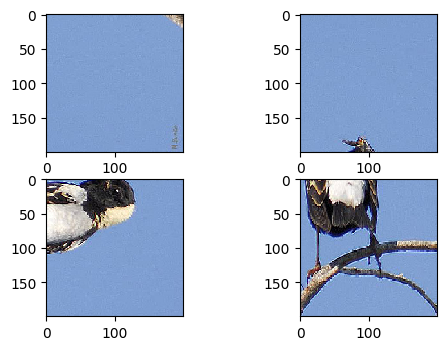

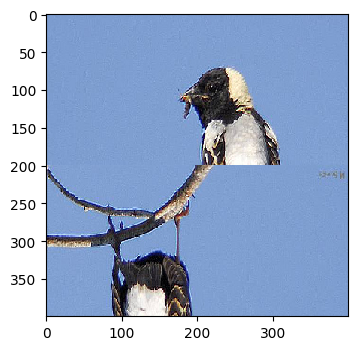

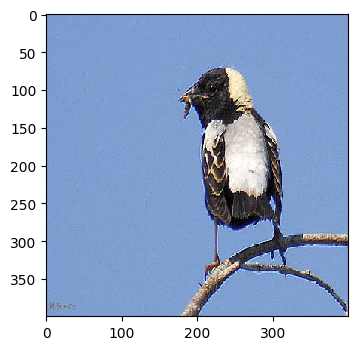

In correct position: 2
In correct position and rotation: 2
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0019_2509438067.jpg...
****************
puzzle_piece_length is 200
puzzle_piece_width is 200
no of rows are 2
no of cols are 2
no_of_puzzle_pieces are 4


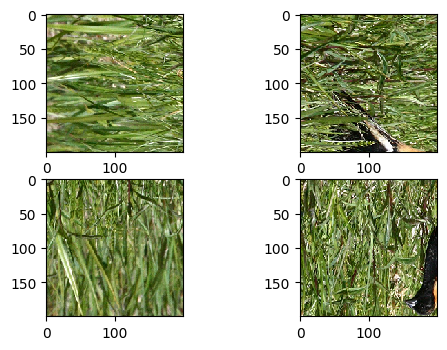

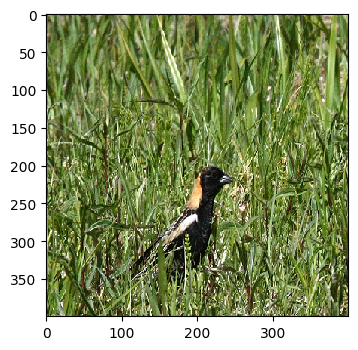

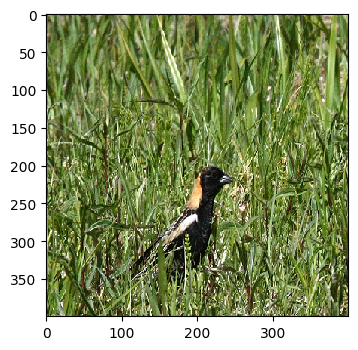

In correct position: 4
In correct position and rotation: 4
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0011_2578725502.jpg...
****************
puzzle_piece_length is 200
puzzle_piece_width is 200
no of rows are 2
no of cols are 2
no_of_puzzle_pieces are 4


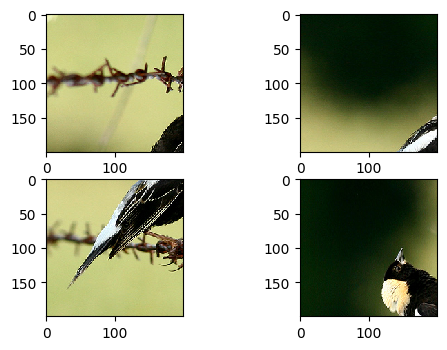

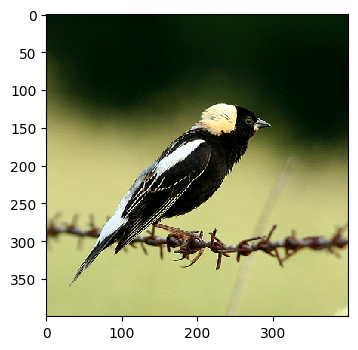

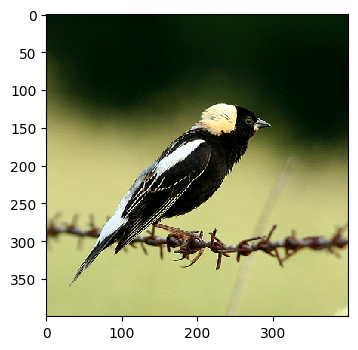

In correct position: 4
In correct position and rotation: 4
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0022_2576769628.jpg...
****************
puzzle_piece_length is 200
puzzle_piece_width is 200
no of rows are 2
no of cols are 2
no_of_puzzle_pieces are 4


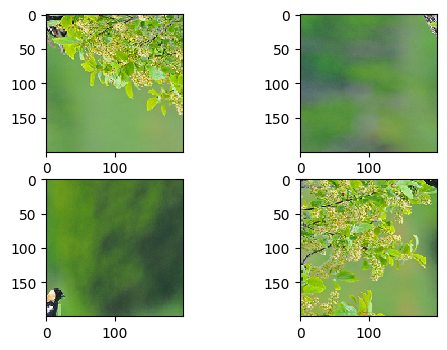

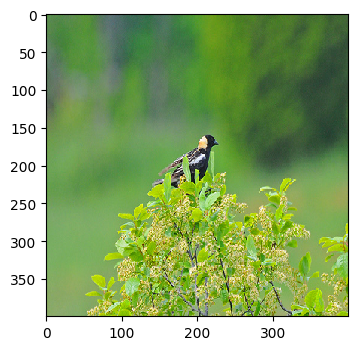

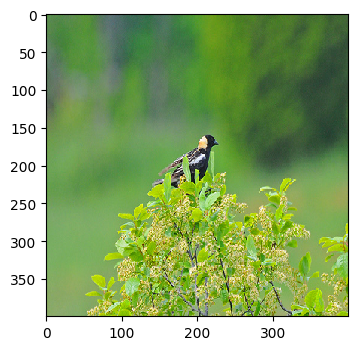

In correct position: 4
In correct position and rotation: 4
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0003_433654869.jpg...
****************
puzzle_piece_length is 200
puzzle_piece_width is 200
no of rows are 2
no of cols are 2
no_of_puzzle_pieces are 4


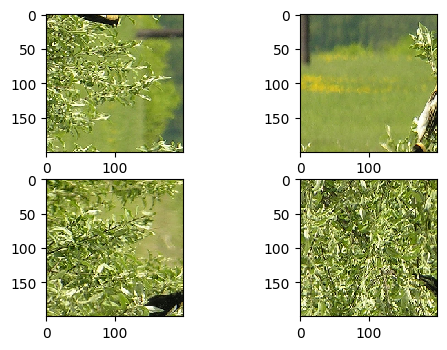

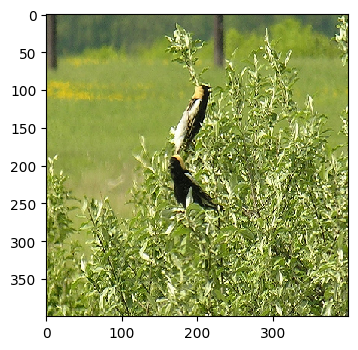

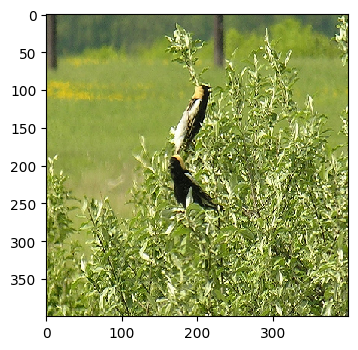

In correct position: 4
In correct position and rotation: 4


In [44]:
for image_file in sample(os.listdir(file_dir_name), 5):
    image_file = os.path.join(file_dir_name,image_file)
    solve_example(image_file,puzzle_square_piece_dim, resnet_dim)
    

In [45]:
new_puzzle_square_piece_dim = 150



Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0006_323626208.jpg...
****************
puzzle_piece_length is 150
puzzle_piece_width is 150
no of rows are 2
no of cols are 2
no_of_puzzle_pieces are 4


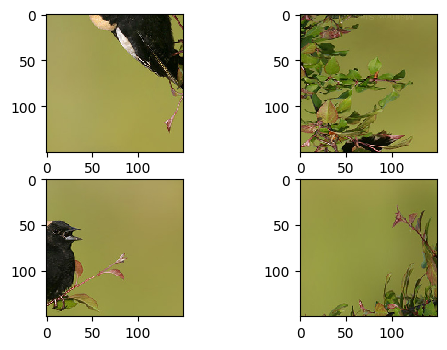

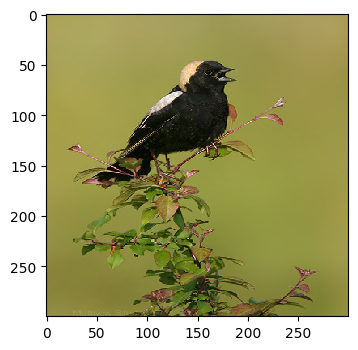

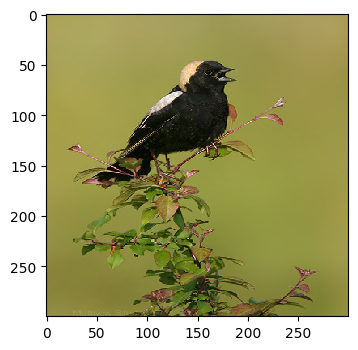

In correct position: 4
In correct position and rotation: 4
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0012_2577892497.jpg...
****************
puzzle_piece_length is 150
puzzle_piece_width is 150
no of rows are 2
no of cols are 2
no_of_puzzle_pieces are 4


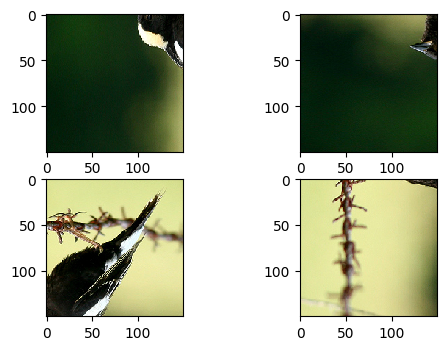

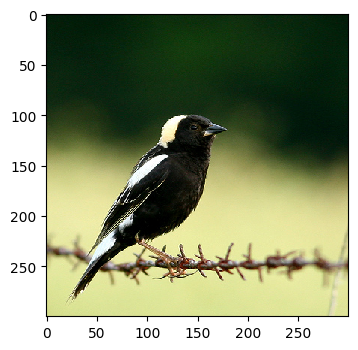

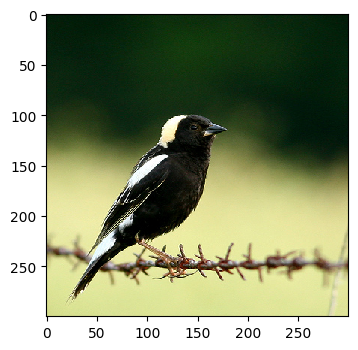

In correct position: 4
In correct position and rotation: 4
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0020_2665731300.jpg...
****************
puzzle_piece_length is 150
puzzle_piece_width is 150
no of rows are 3
no of cols are 3
no_of_puzzle_pieces are 9


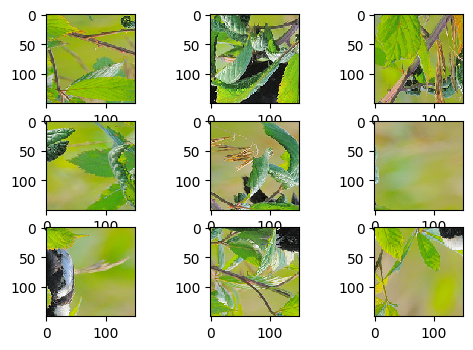

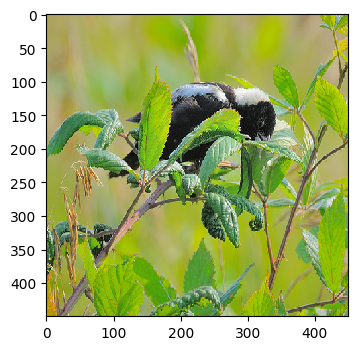

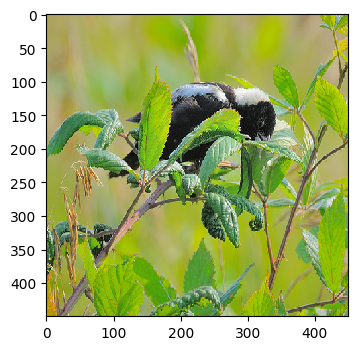

In correct position: 9
In correct position and rotation: 9
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0022_2576769628.jpg...
****************
puzzle_piece_length is 150
puzzle_piece_width is 150
no of rows are 3
no of cols are 3
no_of_puzzle_pieces are 9


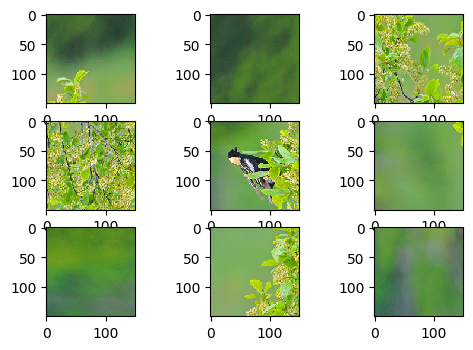

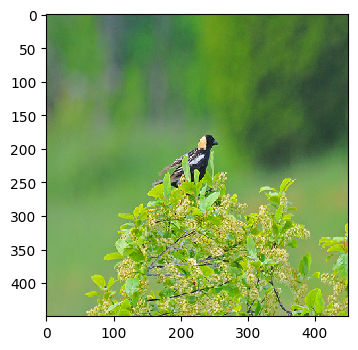

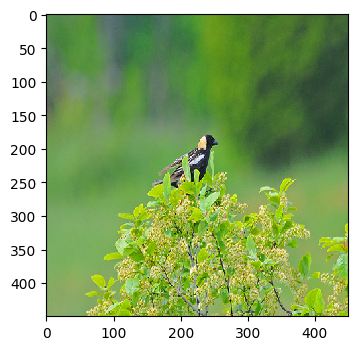

In correct position: 9
In correct position and rotation: 8
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0009_2497220773.jpg...
****************
puzzle_piece_length is 150
puzzle_piece_width is 150
no of rows are 3
no of cols are 3
no_of_puzzle_pieces are 9


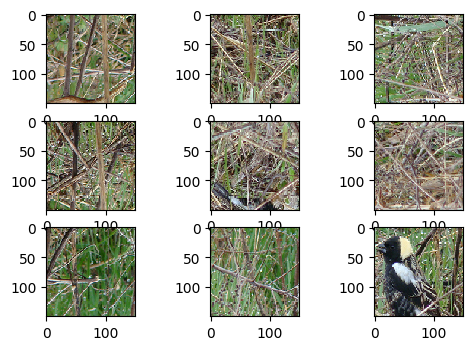

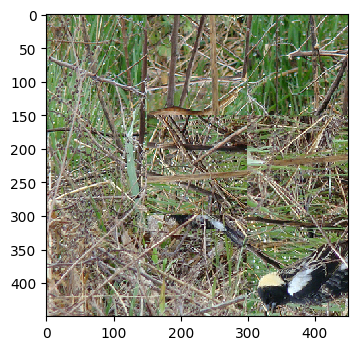

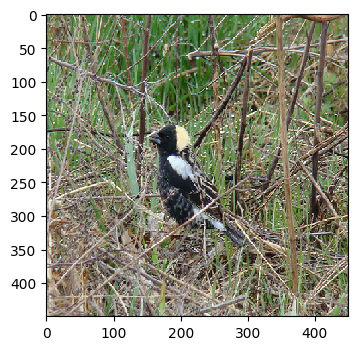

In correct position: 4
In correct position and rotation: 4


In [46]:
for image_file in sample(os.listdir(file_dir_name), 5):
    image_file = os.path.join(file_dir_name,image_file)
    solve_example(image_file,new_puzzle_square_piece_dim, resnet_dim)
    

In [47]:
show_solving_progress = True

Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0024_2526087426.jpg...
****************
puzzle_piece_length is 150
puzzle_piece_width is 150
no of rows are 2
no of cols are 2
no_of_puzzle_pieces are 4


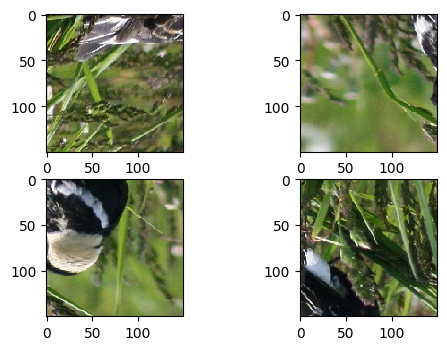

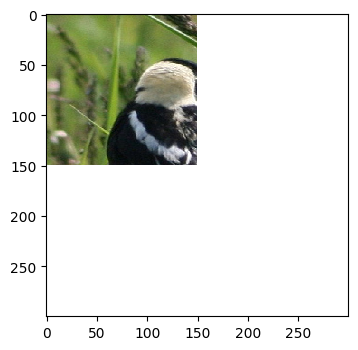

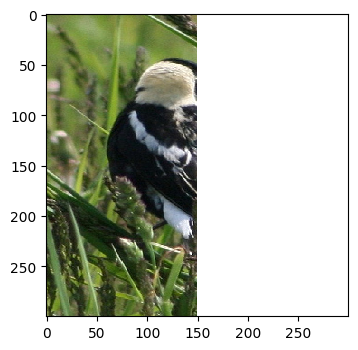

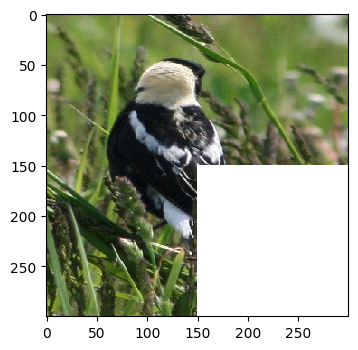

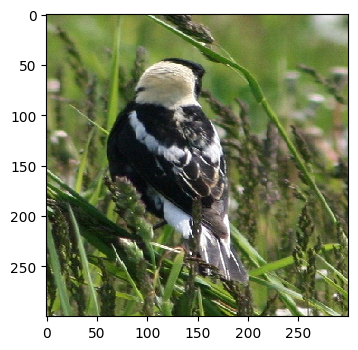

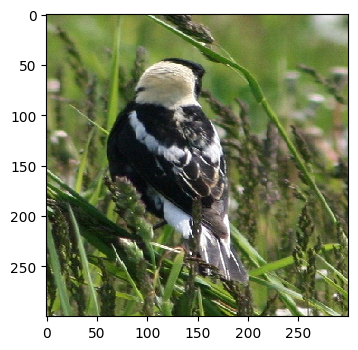

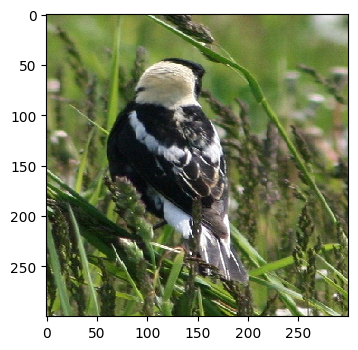

In correct position: 4
In correct position and rotation: 4
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0018_2616868506.jpg...
****************
puzzle_piece_length is 150
puzzle_piece_width is 150
no of rows are 3
no of cols are 3
no_of_puzzle_pieces are 9


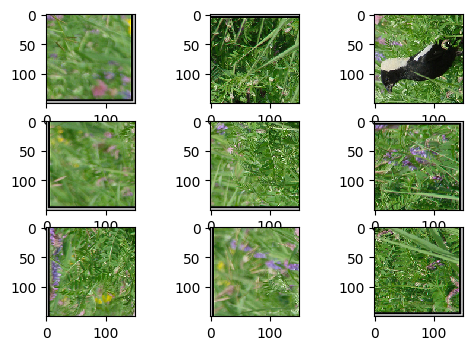

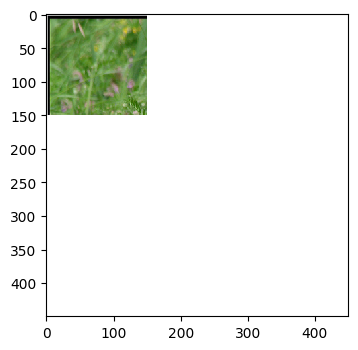

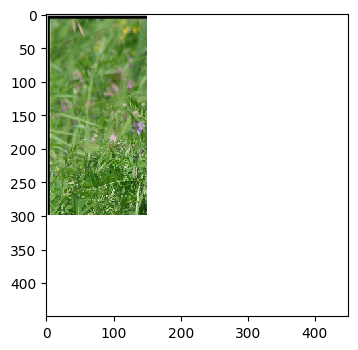

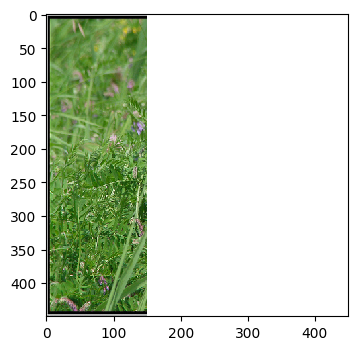

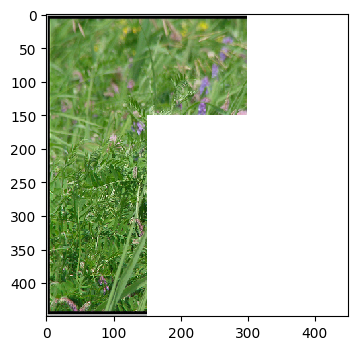

...

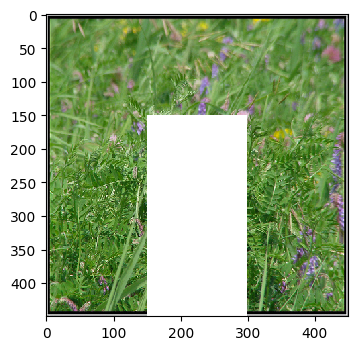

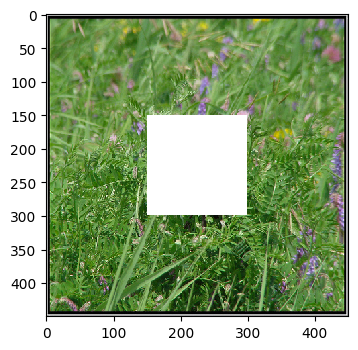

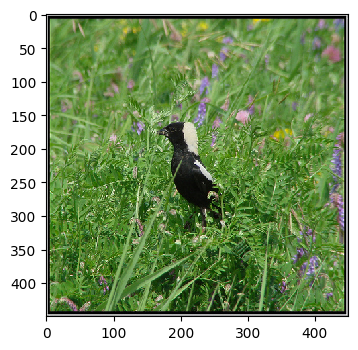

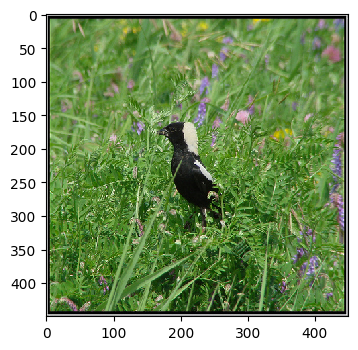

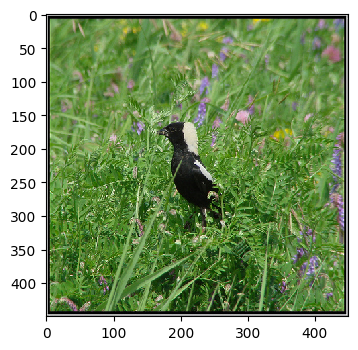

In correct position: 9
In correct position and rotation: 9
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0017_2254397578.jpg...
****************
puzzle_piece_length is 150
puzzle_piece_width is 150
no of rows are 2
no of cols are 2
no_of_puzzle_pieces are 4


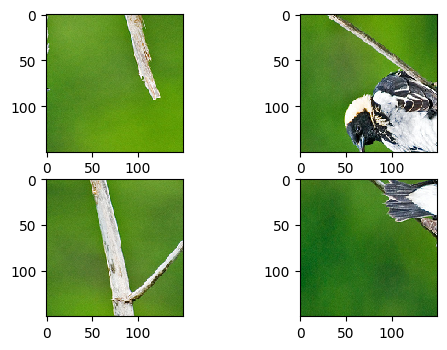

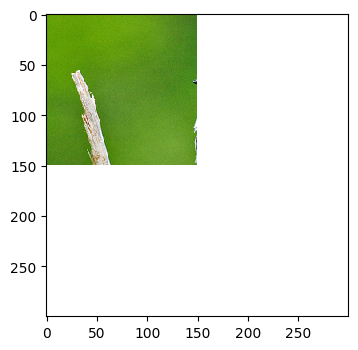

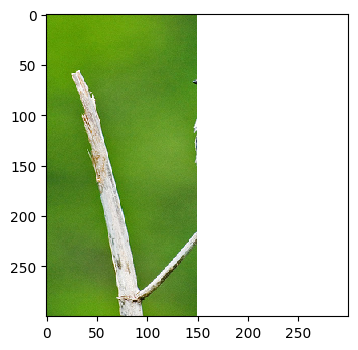

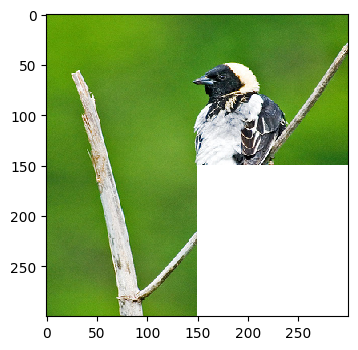

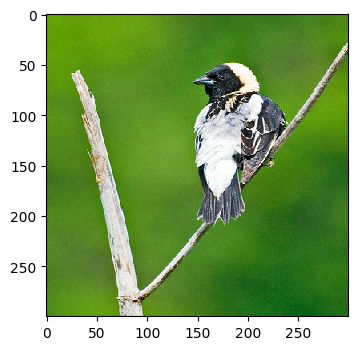

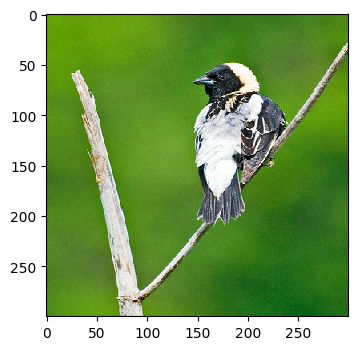

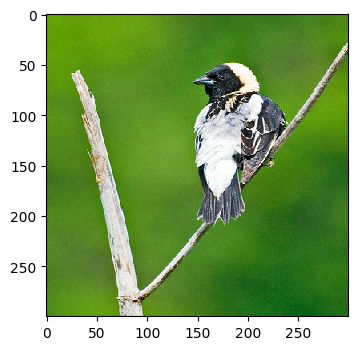

In correct position: 4
In correct position and rotation: 4
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0023_2486988341.jpg...
****************
puzzle_piece_length is 150
puzzle_piece_width is 150
no of rows are 2
no of cols are 2
no_of_puzzle_pieces are 4


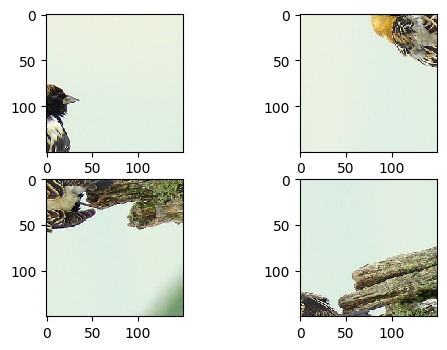

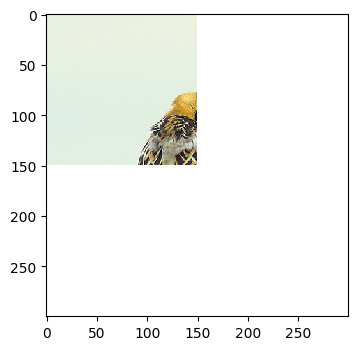

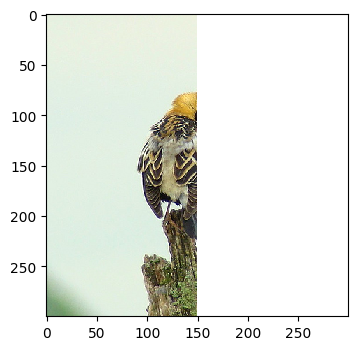

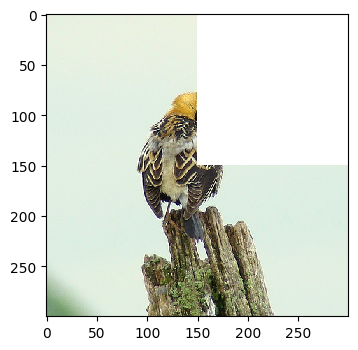

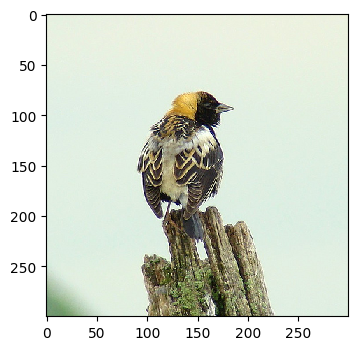

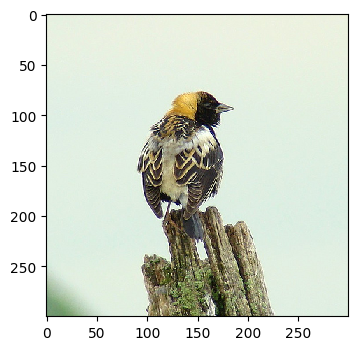

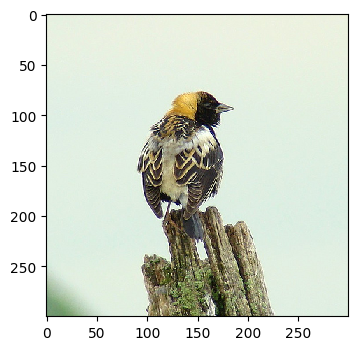

In correct position: 4
In correct position and rotation: 4
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0004_2563658093.jpg...
****************
puzzle_piece_length is 150
puzzle_piece_width is 150
no of rows are 3
no of cols are 3
no_of_puzzle_pieces are 9


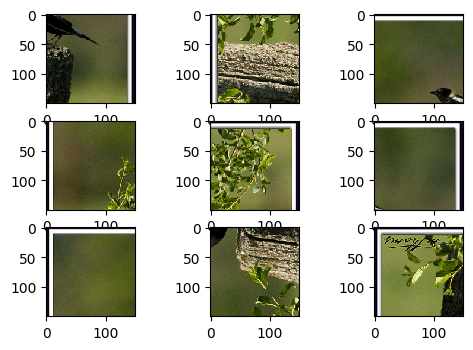

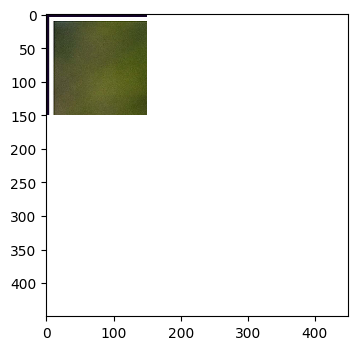

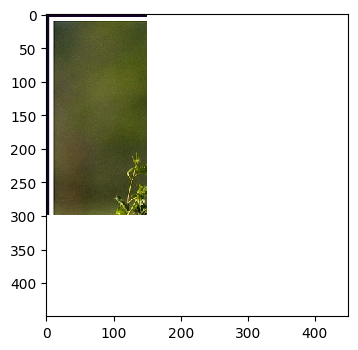

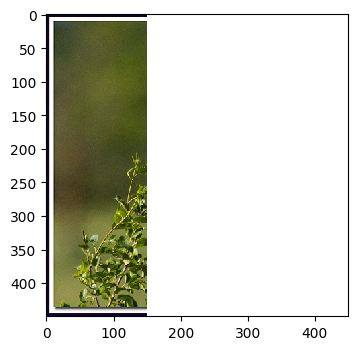

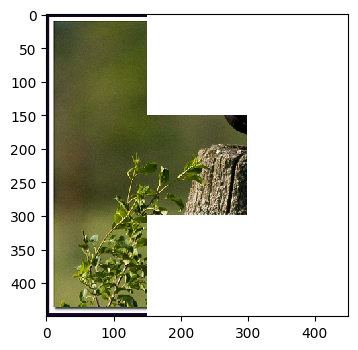

...

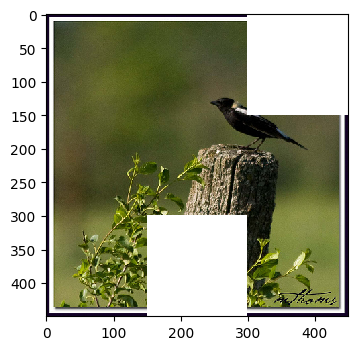

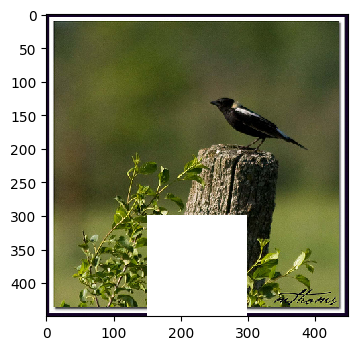

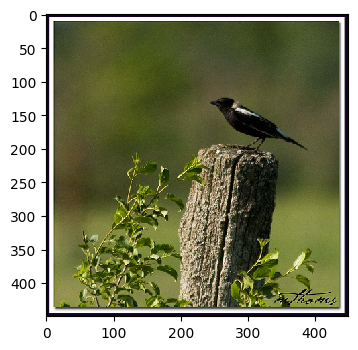

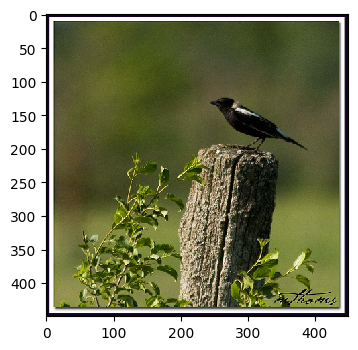

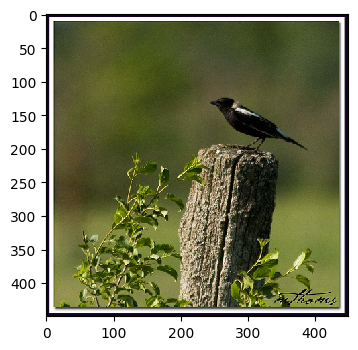

In correct position: 9
In correct position and rotation: 9


In [48]:
new_puzzle_square_piece_dim = 150
for image_file in sample(os.listdir(file_dir_name), 5):
    image_file = os.path.join(file_dir_name,image_file)
    solve_example(image_file,new_puzzle_square_piece_dim, resnet_dim)
    

In [51]:
show_solving_progress = True

Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0025_2502658999.jpg...
****************
puzzle_piece_length is 100
puzzle_piece_width is 100
no of rows are 4
no of cols are 4
no_of_puzzle_pieces are 16


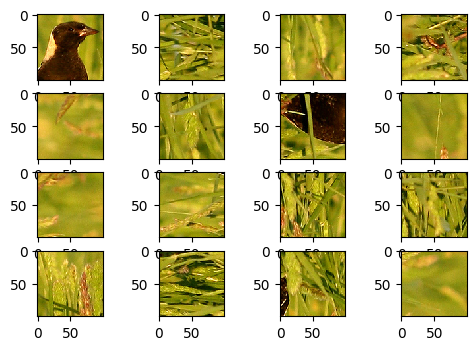

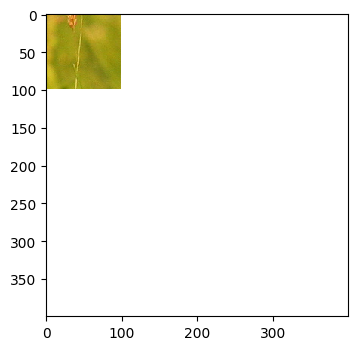

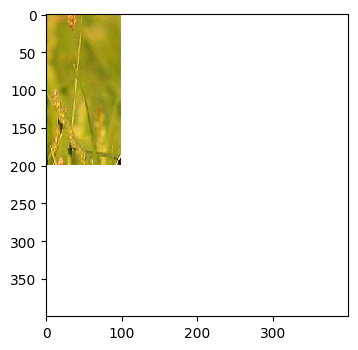

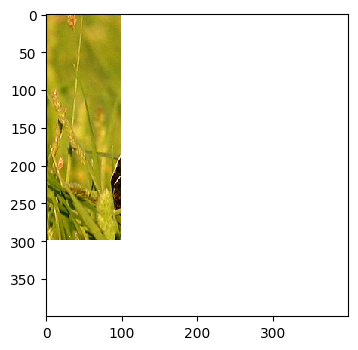

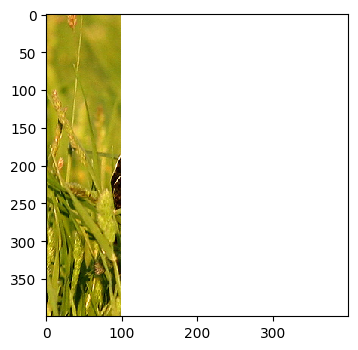

...

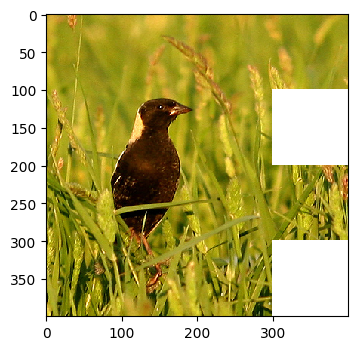

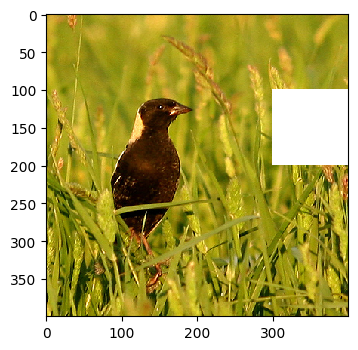

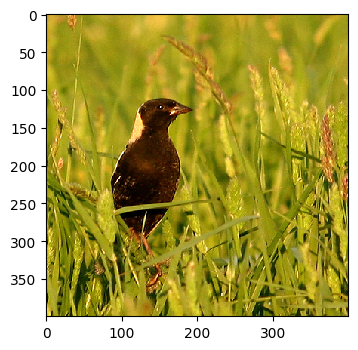

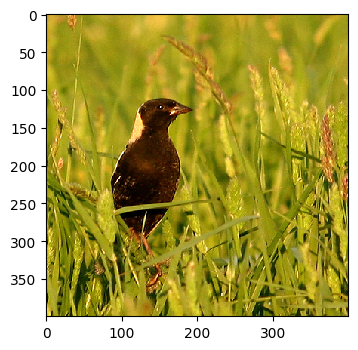

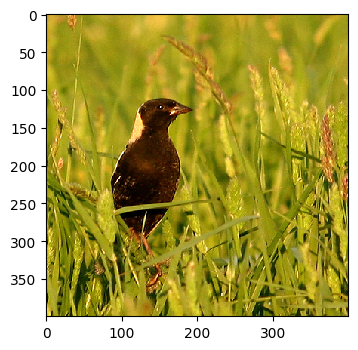

In correct position: 16
In correct position and rotation: 16
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0003_433654869.jpg...
****************
puzzle_piece_length is 100
puzzle_piece_width is 100
no of rows are 5
no of cols are 5
no_of_puzzle_pieces are 25


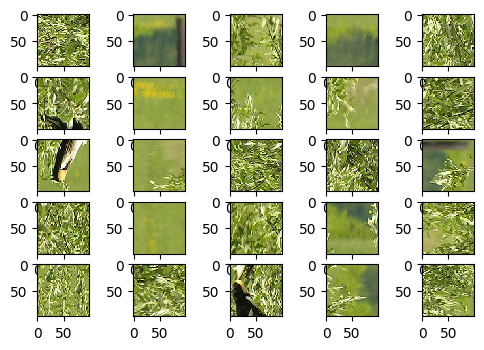

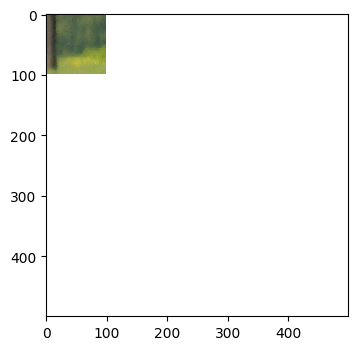

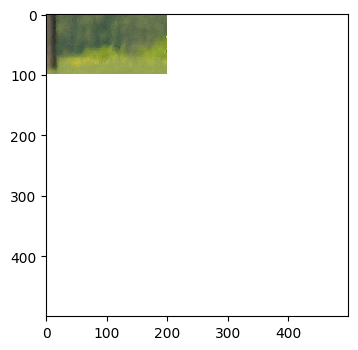

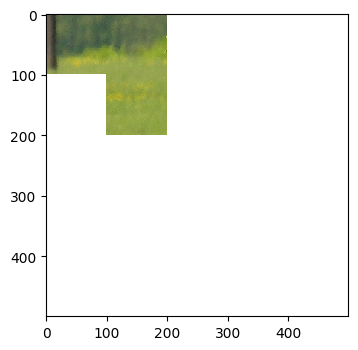

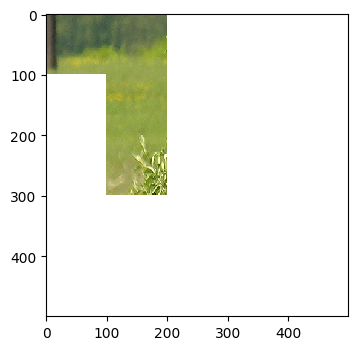

...

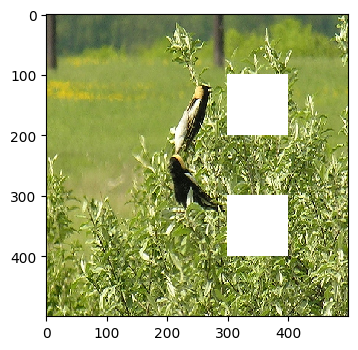

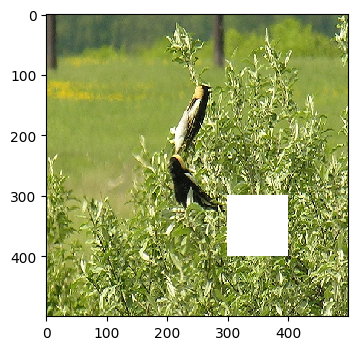

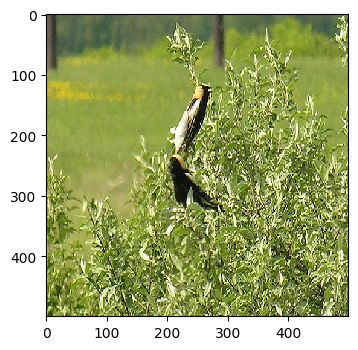

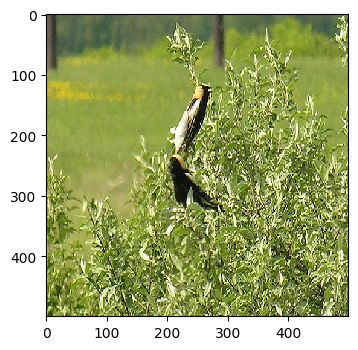

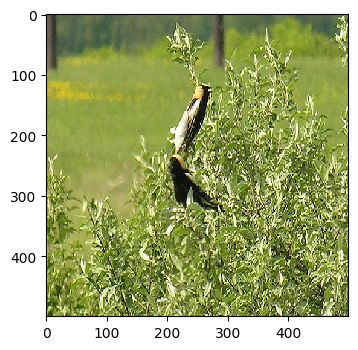

In correct position: 25
In correct position and rotation: 25
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0006_323626208.jpg...
****************
puzzle_piece_length is 100
puzzle_piece_width is 100
no of rows are 3
no of cols are 3
no_of_puzzle_pieces are 9


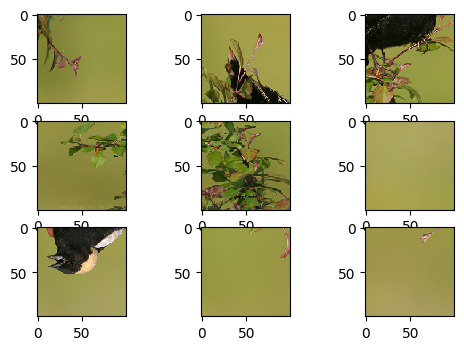

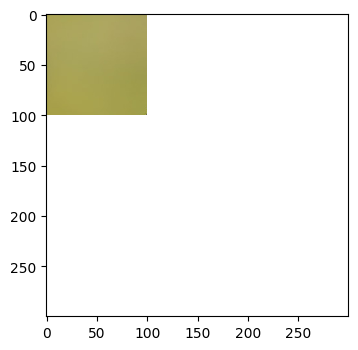

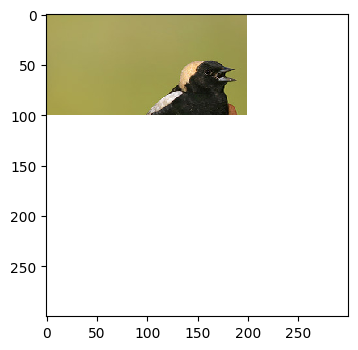

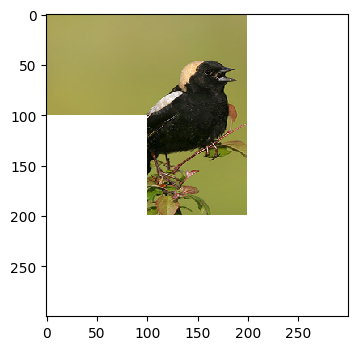

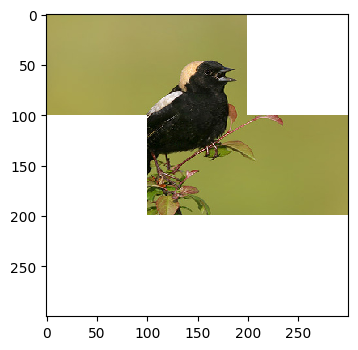

...

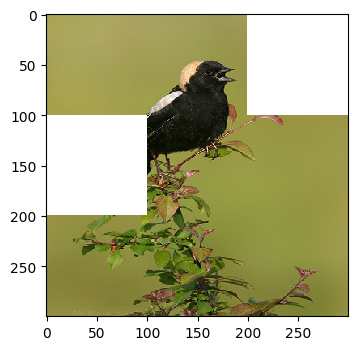

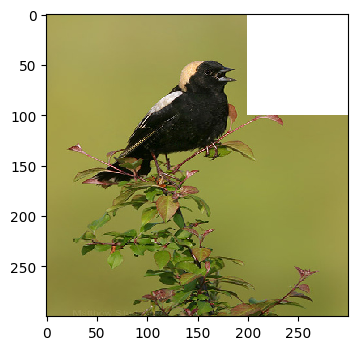

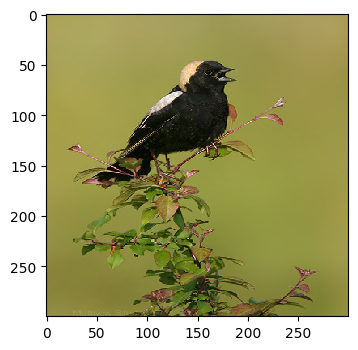

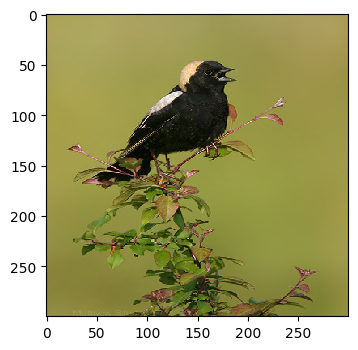

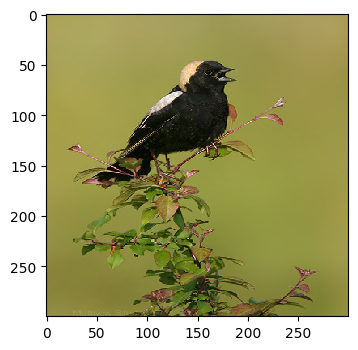

In correct position: 9
In correct position and rotation: 9
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0024_2526087426.jpg...
****************
puzzle_piece_length is 100
puzzle_piece_width is 100
no of rows are 3
no of cols are 3
no_of_puzzle_pieces are 9


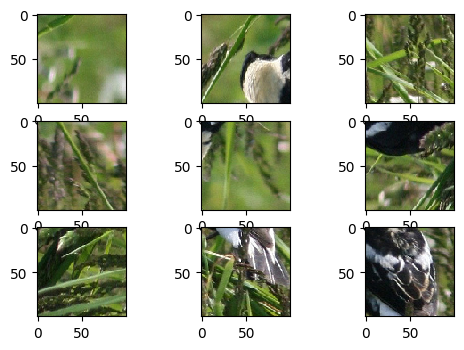

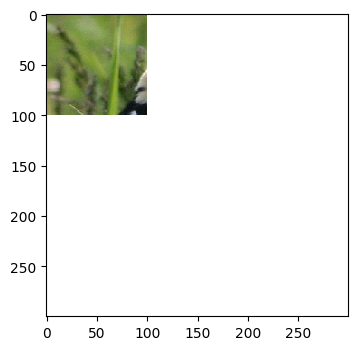

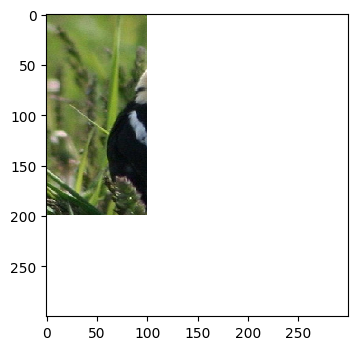

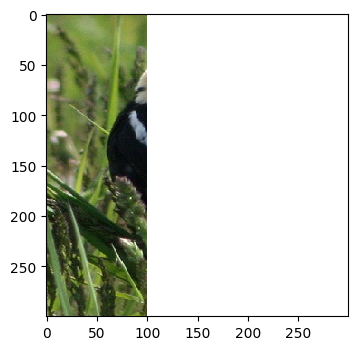

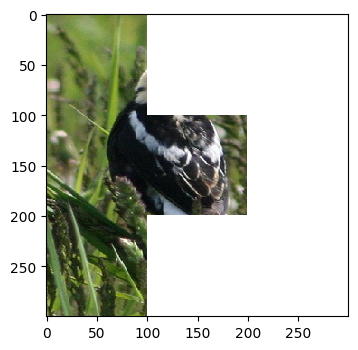

...

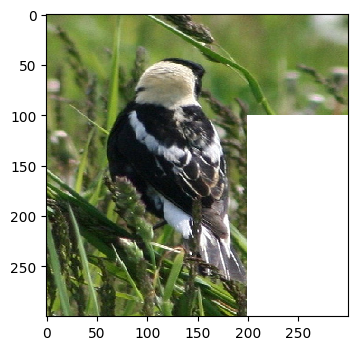

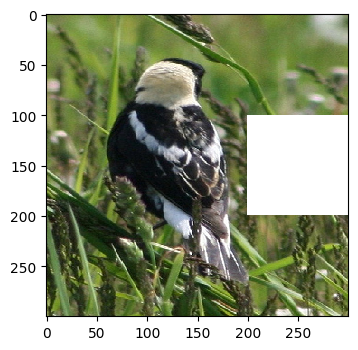

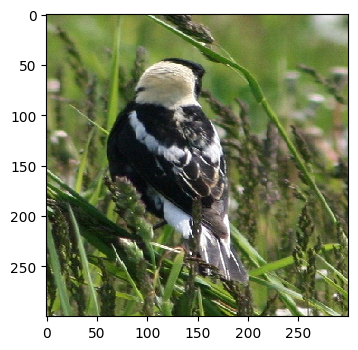

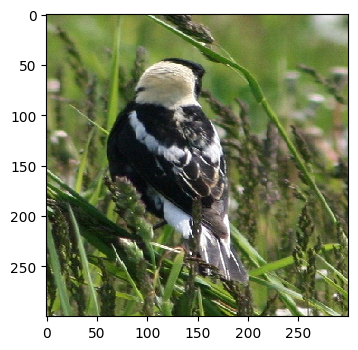

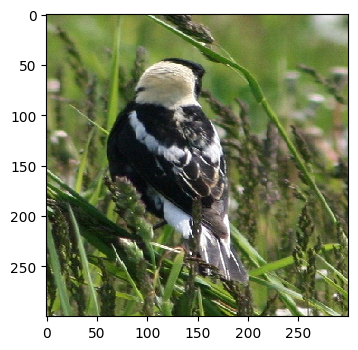

In correct position: 9
In correct position and rotation: 9
Solving /Users/ideallaedi/Desktop/Jigsaw_AI/CUB_200_dataset/CUB_200_images/013.Bobolink/Bobolink_0021_2563472456.jpg...
****************
puzzle_piece_length is 100
puzzle_piece_width is 100
no of rows are 5
no of cols are 5
no_of_puzzle_pieces are 25


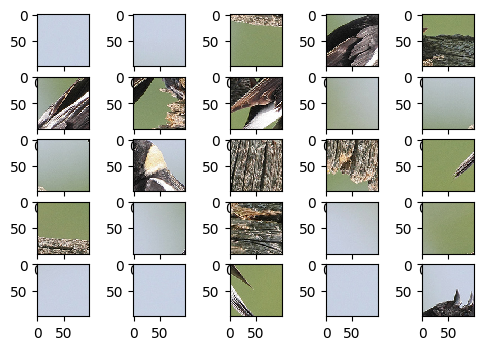

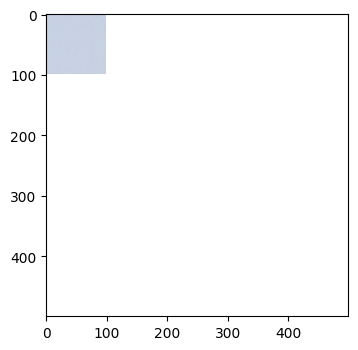

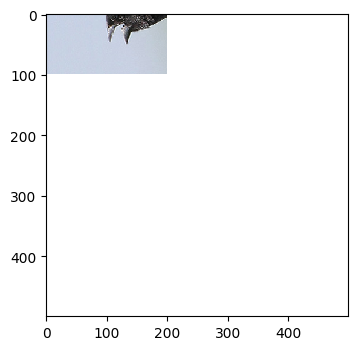

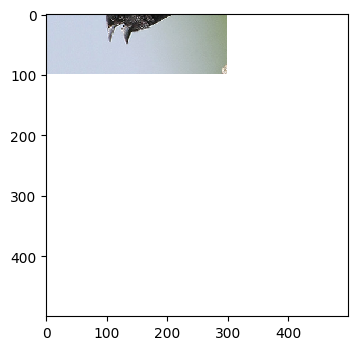

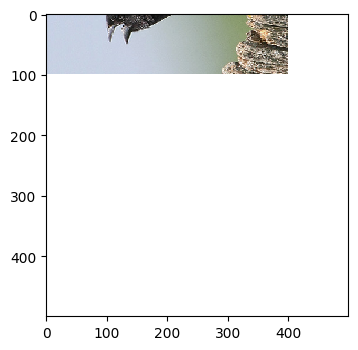

...

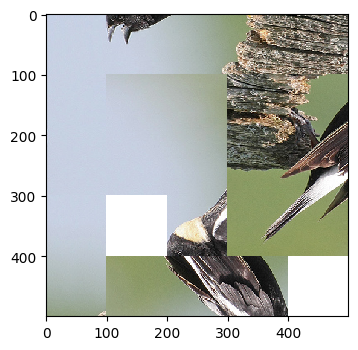

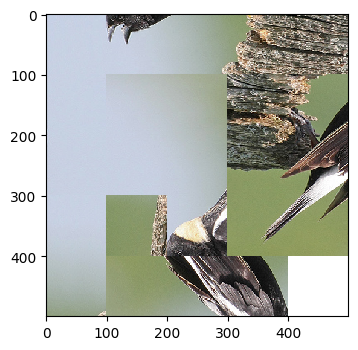

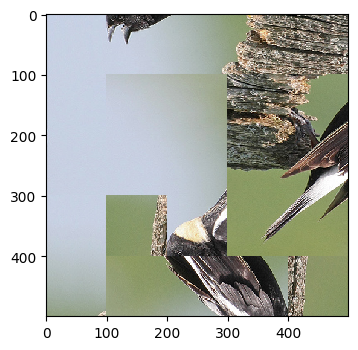

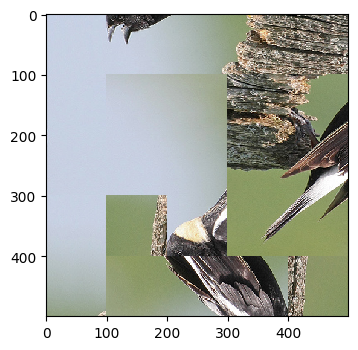

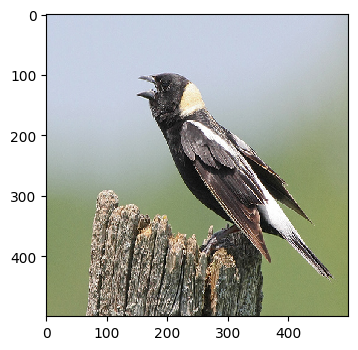

In correct position: 2
In correct position and rotation: 1


In [52]:
new_puzzle_square_piece_dim = 100
for image_file in sample(os.listdir(file_dir_name), 5):
    image_file = os.path.join(file_dir_name,image_file)
    solve_example(image_file,new_puzzle_square_piece_dim, resnet_dim)